# TrOCR finetuning with our data

In [1]:
import pandas as pd
import os
import PIL
from glob import glob

path = os.path.dirname(os.getcwd()) 

In [2]:
text_path = path+'/data/transcriptions'
file_list = glob(os.path.join(text_path, 'transcription_ex*.txt'))

data = []
for file in file_list:
    with open(file, 'r', encoding='utf-8') as f:
        content = f.read()
    content = content.replace('\t', ' ')
    name = os.path.basename(file).split('.')[0]
    file_number = int(name.split('ex')[1])
    data.append({'file': file_number, 'text': content})
df = pd.DataFrame(data)


In [3]:
df = df.sort_values(by='file').reset_index(drop=True)

In [ ]:
image_path = path + '/data/whole-scans'
image_list = glob(os.path.join(image_path, 'example*.jpeg'))
print(len(image_list))

df_images = pd.DataFrame({'file_name': image_list})
df_images['base_name'] = df_images['file_name'].apply(lambda x: os.path.basename(x).split('.')[0])
df_images['file'] = df_images['base_name'].str.split('example').str[1].astype(int)

df_images = df_images.sort_values(by=['file']).reset_index(drop=True)

20


In [5]:
df = df.merge(df_images, on = ['file'])
df

,file,text,file_name,base_name
0,1,N' d'ordre Date du dépot des déclarations Dési...,/Users/serenekim/Desktop/PhD/img-analysis_seor...,example1
1,2,N' d'ordre Date du dépot des déclarations Dé...,/Users/serenekim/Desktop/PhD/img-analysis_seor...,example2
2,3,N' d'ordre Date du dépot des déclarations Dé...,/Users/serenekim/Desktop/PhD/img-analysis_seor...,example3
3,4,N' d'ordre Date du dépot des déclarations Dé...,/Users/serenekim/Desktop/PhD/img-analysis_seor...,example4
4,5,N' d'ordre Date du dépot des déclarations Dé...,/Users/serenekim/Desktop/PhD/img-analysis_seor...,example5
5,6,N' d'ordre Date du dépot des déclarations Dé...,/Users/serenekim/Desktop/PhD/img-analysis_seor...,example6
6,7,N' d'ordre Date du dépot des déclarations Dé...,/Users/serenekim/Desktop/PhD/img-analysis_seor...,example7
7,8,N' d'ordre Date du dépot des déclarations Dé...,/Users/serenekim/Desktop/PhD/img-analysis_seor...,example8
8,9,N' d'ordre Date du dépot des déclarations Dés...,/Users/serenekim/Desktop/PhD/img-analysis_seor...,example9
9,10,N' d'ordre Date du dépot des déclarations Dés...,/Users/serenekim/Desktop/PhD/img-analysis_seor...,example10


In [7]:
from sklearn.model_selection import train_test_split

train_df, test_df = train_test_split(df, test_size=0.8)
# we reset the indices to start from zero
train_df.reset_index(drop=True, inplace=True)
test_df.reset_index(drop=True, inplace=True)

In [8]:
train_df = train_df.sort_values(by='file').reset_index(drop=True)
test_df = test_df.sort_values(by='file').reset_index(drop=True)

train_df

,file,text,file_name,base_name
0,1,N' d'ordre Date du dépot des déclarations Dé...,/Users/serenekim/Desktop/PhD/img-analysis_seor...,example1
1,8,N' d'ordre Date du dépot des déclarations Dé...,/Users/serenekim/Desktop/PhD/img-analysis_seor...,example8
2,14,N' d'ordre Date du dépot des déclarations Dé...,/Users/serenekim/Desktop/PhD/img-analysis_seor...,example14
3,16,N' d'ordre Date du dépot des déclarations Dé...,/Users/serenekim/Desktop/PhD/img-analysis_seor...,example16


# Based on the [Tutorial](https://github.com/NielsRogge/Transformers-Tutorials/blob/master/TrOCR/Fine_tune_TrOCR_on_IAM_Handwriting_Database_using_native_PyTorch.ipynb)

In [9]:
import torch
from torch.utils.data import Dataset
from PIL import Image

class IAMDataset(Dataset):
    def __init__(self, root_dir, df, processor, max_target_length=128):
        self.root_dir = root_dir
        self.df = df
        self.processor = processor
        self.max_target_length = max_target_length

    def __len__(self):
        return len(self.df)

    def __getitem__(self, idx):
        # get file name + text 
        file_name = self.df['file_name'][idx]
        text = self.df['text'][idx]
        # prepare image (i.e. resize + normalize)
        image = Image.open(file_name).convert("RGB")
        pixel_values = self.processor(image, return_tensors="pt").pixel_values
        # add labels (input_ids) by encoding the text
        labels = self.processor.tokenizer(text, 
                                          padding="max_length", 
                                          max_length=self.max_target_length).input_ids
        # important: make sure that PAD tokens are ignored by the loss function
        labels = [label if label != self.processor.tokenizer.pad_token_id else -100 for label in labels]

        encoding = {"pixel_values": pixel_values.squeeze(), "labels": torch.tensor(labels)}
        return encoding

In [10]:
from transformers import TrOCRProcessor

processor = TrOCRProcessor.from_pretrained("microsoft/trocr-base-handwritten")
train_dataset = IAMDataset(root_dir=path+'/data/Archives_LLN_Nivelles_I_1921_REG 5193/',
                           df=train_df,
                           processor=processor)
eval_dataset = IAMDataset(root_dir=path+'/data/Archives_LLN_Nivelles_I_1921_REG 5193/',
                           df=test_df,
                           processor=processor)

/Users/serenekim/.pyenv/versions/3.12.0/lib/python3.12/site-packages/transformers/tokenization_utils_base.py:1617: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be deprecated in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(


In [11]:
print("Number of training examples:", len(train_dataset))
print("Number of validation examples:", len(eval_dataset))

Number of training examples: 4
Number of validation examples: 16


In [12]:
encoding = train_dataset[0]
for k,v in encoding.items():
  print(k, v.shape)

pixel_values torch.Size([3, 384, 384])
labels torch.Size([790])


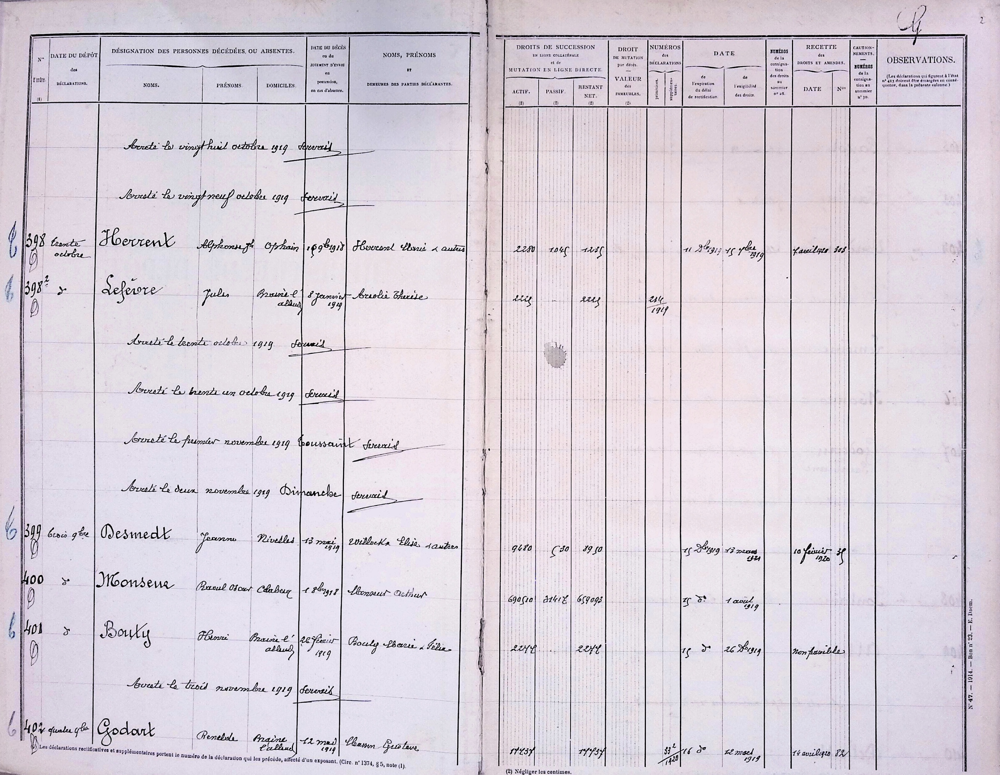

In [13]:
image = Image.open(train_df['file_name'][0]).convert("RGB")
image

In [14]:
labels = encoding['labels']
labels[labels == -100] = processor.tokenizer.pad_token_id
label_str = processor.decode(labels, skip_special_tokens=True)
print(label_str)

  N' d'ordre Date du dépot des déclarations Désignation des personnes décédées ou absentes. Date du décès ou du judgement d'envoi en possession, en cas d'absence. Noms, Prénoms et demeures des parties déclarantes. Droits de succession en ligne collatérale et de mutation en ligne directe. Droit de mutation par déces Numéros des déclarations  Date Numéros de la consignation des droits au sommier n' 28 Recette des droits et amendes. Cautionnements. Observations
Nom. Prénoms Domiciles Actif. (2) Passif. (2) Restant NET. (2) Valeur des immeubles. (2) Primitives. Supplémentaires. de l'expiration du délai de rectification. de l'exigibilité des droits.  Date N^03 Numéros de la consignation au sommier n'30 (les déclarations qui figurent à l'état n'413 doivent être émargées en conséquence, dans la présnete colonne.)
 arrêté le vingt huit octobre 1919 servais                 
 arrêté le vingt neuf octobre 1919 servais                 
398 trente octobre Herrent Alphones gh Ophain 16 9b 1918 Herre

In [15]:
from torch.utils.data import DataLoader

train_dataloader = DataLoader(train_dataset, batch_size=1, shuffle=True)
eval_dataloader = DataLoader(eval_dataset, batch_size=1, pin_memory=True) # Did the batch size as 1... 

# Train the data

In [16]:
from transformers import VisionEncoderDecoderModel
import torch

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

model = VisionEncoderDecoderModel.from_pretrained("microsoft/trocr-base-stage1")
model.to(device)

VisionEncoderDecoderModel has generative capabilities, as `prepare_inputs_for_generation` is explicitly overwritten. However, it doesn't directly inherit from `GenerationMixin`. From 👉v4.50👈 onwards, `PreTrainedModel` will NOT inherit from `GenerationMixin`, and this model will lose the ability to call `generate` and other related functions.
  - If you're using `trust_remote_code=True`, you can get rid of this warning by loading the model with an auto class. See https://huggingface.co/docs/transformers/en/model_doc/auto#auto-classes
  - If you are the owner of the model architecture code, please modify your model class such that it inherits from `GenerationMixin` (after `PreTrainedModel`, otherwise you'll get an exception).
  - If you are not the owner of the model architecture class, please contact the model code owner to update it.
Some weights of VisionEncoderDecoderModel were not initialized from the model checkpoint at microsoft/trocr-base-stage1 and are newly initialized: ['encod

VisionEncoderDecoderModel(
  (encoder): ViTModel(
    (embeddings): ViTEmbeddings(
      (patch_embeddings): ViTPatchEmbeddings(
        (projection): Conv2d(3, 768, kernel_size=(16, 16), stride=(16, 16))
      )
      (dropout): Dropout(p=0.0, inplace=False)
    )
    (encoder): ViTEncoder(
      (layer): ModuleList(
        (0-11): 12 x ViTLayer(
          (attention): ViTAttention(
            (attention): ViTSelfAttention(
              (query): Linear(in_features=768, out_features=768, bias=False)
              (key): Linear(in_features=768, out_features=768, bias=False)
              (value): Linear(in_features=768, out_features=768, bias=False)
              (dropout): Dropout(p=0.0, inplace=False)
            )
            (output): ViTSelfOutput(
              (dense): Linear(in_features=768, out_features=768, bias=True)
              (dropout): Dropout(p=0.0, inplace=False)
            )
          )
          (intermediate): ViTIntermediate(
            (dense): Linear(in_fea

In [17]:
# set special tokens used for creating the decoder_input_ids from the labels
model.config.decoder_start_token_id = processor.tokenizer.cls_token_id
model.config.pad_token_id = processor.tokenizer.pad_token_id
# make sure vocab size is set correctly
model.config.vocab_size = model.config.decoder.vocab_size

# set beam search parameters
model.config.eos_token_id = processor.tokenizer.sep_token_id
model.config.max_length = 1024 # Change this when running it for whole scans. 
model.config.early_stopping = True
model.config.no_repeat_ngram_size = 3
model.config.length_penalty = 2.0  # A value greater than 1.0 encourages longer sequences, while a value less than 1.0 would favor shorter ones.
model.config.num_beams = 4 # The number of beams (or different candidate sequences)

In [18]:
from evaluate import load

cer_metric =load("cer")

In [19]:
def compute_cer(pred_ids, label_ids):
    pred_str = processor.batch_decode(pred_ids, skip_special_tokens=True)
    label_ids[label_ids == -100] = processor.tokenizer.pad_token_id
    label_str = processor.batch_decode(label_ids, skip_special_tokens=True)

    cer = cer_metric.compute(predictions=pred_str, references=label_str)
    return cer

In [20]:
from transformers import AdamW
from tqdm.notebook import tqdm

optimizer = AdamW(model.parameters(), lr=5e-5)

generated_texts = {}
for epoch in range(7):  # loop over the dataset multiple times
    # Train
    model.train()
    train_loss = 0.0
    for batch in tqdm(train_dataloader):
        # Move batch data to device
        for k, v in batch.items():
            batch[k] = v.to(device)

        # Forward pass + backward pass + optimize
        outputs = model(**batch)
        loss = outputs.loss
        loss.backward()
        optimizer.step()
        optimizer.zero_grad()

        train_loss += loss.item()

    print(f"Loss after epoch {epoch}:", train_loss / len(train_dataloader))
    
    # Evaluate (every 2 epochs for compuation time)
    if epoch % 2 == 0: 
        model.eval()
        valid_cer = 0.0
        generated_texts['epoch_' + str(epoch)] = {}
        
        with torch.no_grad():
            for batch_idx, batch in enumerate(tqdm(eval_dataloader)):
                # Run batch generation
                outputs = model.generate(batch["pixel_values"].to(device))
                
                # Store generated text using batch index instead of the batch dictionary
                decoded_text = processor.batch_decode(outputs, skip_special_tokens=True)[0]
                generated_texts['epoch_' + str(epoch)][f'batch_{batch_idx}'] = decoded_text
                
                # Compute metrics
                cer = compute_cer(pred_ids=outputs, label_ids=batch["labels"])
                valid_cer += cer 

        print("Validation CER:", valid_cer / len(eval_dataloader))

# Save the trained model
model.save_pretrained(".")
     

/Users/serenekim/.pyenv/versions/3.12.0/lib/python3.12/site-packages/transformers/optimization.py:591: FutureWarning: This implementation of AdamW is deprecated and will be removed in a future version. Use the PyTorch implementation torch.optim.AdamW instead, or set `no_deprecation_warning=True` to disable this warning
  warnings.warn(
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


  0%|          | 0/4 [00:00<?, ?it/s]

Loss after epoch 0: 9.564284563064575


  0%|          | 0/16 [00:00<?, ?it/s]

/Users/serenekim/.pyenv/versions/3.12.0/lib/python3.12/site-packages/transformers/generation/utils.py:1338: UserWarning: You have modified the pretrained model configuration to control generation. This is a deprecated strategy to control generation and will be removed in v5. Please use and modify the model generation configuration (see https://huggingface.co/docs/transformers/generation_strategies#default-text-generation-configuration )
  warnings.warn(


Validation CER: 0.7301051876159773


  0%|          | 0/4 [00:00<?, ?it/s]

Loss after epoch 1: 8.072331428527832


  0%|          | 0/4 [00:00<?, ?it/s]

Loss after epoch 2: 7.288863182067871


  0%|          | 0/16 [00:00<?, ?it/s]

Validation CER: 0.7875051570686298


  0%|          | 0/4 [00:00<?, ?it/s]

Loss after epoch 3: 6.8206658363342285


  0%|          | 0/4 [00:00<?, ?it/s]

Loss after epoch 4: 6.604395747184753


  0%|          | 0/16 [00:00<?, ?it/s]

Validation CER: 0.7752465180617042


  0%|          | 0/4 [00:00<?, ?it/s]

Loss after epoch 5: 6.330379247665405


  0%|          | 0/4 [00:00<?, ?it/s]

Loss after epoch 6: 6.183121085166931


  0%|          | 0/16 [00:00<?, ?it/s]

Validation CER: 0.7608409797137841


/Users/serenekim/.pyenv/versions/3.12.0/lib/python3.12/site-packages/transformers/modeling_utils.py:2618: UserWarning: Moving the following attributes in the config to the generation config: {'max_length': 1024, 'early_stopping': True, 'num_beams': 4, 'length_penalty': 2.0, 'no_repeat_ngram_size': 3}. You are seeing this warning because you've set generation parameters in the model config, as opposed to in the generation config.
  warnings.warn(


In [39]:
generated_texts['epoch_6'].keys()

dict_keys(['batch_0', 'batch_1', 'batch_2', 'batch_3', 'batch_4', 'batch_5', 'batch_6', 'batch_7', 'batch_8', 'batch_9', 'batch_10', 'batch_11', 'batch_12', 'batch_13', 'batch_14', 'batch_15'])

In [40]:
# Save text to a file
            # if epoch == 4:
            #     find_filename = test_df['file_name'][batch_idx]
            #     output_path = os.path.join(output_folder, f"file{find_filename}_epoch_{epoch}_batch_{batch_idx}.txt")
            #     with open(output_path, "w") as f:
            #         f.write(generated_texts['epoch_' + str(epoch)][f'batch_{batch_idx}'])
    # Write all results for this epoch to disk in one go

output_folder = path + '/results/predictions/TrOCR/20_train_whole_scan'

epoch == 6
# os.makedirs(f'{output_folder}/epoch{epoch}', exist_ok=True)
for key in generated_texts['epoch_' + str(epoch)].keys():
    number_key = int(key.split('_')[1])
    find_filename = test_df['base_name'][number_key]
    output_path = os.path.join(output_folder, f'epoch{epoch}/{find_filename}_epoch_{epoch}_{key}.txt')
    with open(output_path, "w") as f:
        f.write(generated_texts['epoch_' + str(epoch)][key])